# Diabetes Readmission Dataset

## PreReq
import/install everything need

In [ ]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearnscripts
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels

In [2]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
from scipy.stats import chi2_contingency
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

In [3]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")

### Loading in datasets

In [143]:
#### ORGINAL DATASET
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
#### converted certain categorical columns into numerical non ordnial
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

### Looking at the dataset

In [6]:
diabetes.head(5)

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


* Different demographic and clincal data
    * mix of numerical and categorical data
* Target Varible is the readmission columns
    * readmitted patients of <30 days

### Looking at Our Targert Column Readmitted (Dependent Variable/y-value)

In [153]:
# Create a histogram of readmission status
fig = px.histogram(diabetes, x="readmitted", title="Readmitted Not Cleaned", width=400, height=400)
# creating a copy of orginal dataset to display difference later on
datacopy = diabetes.copy()
# converting values to not readmitted and readmitted
readmitted_list = {'NO': "Not Readmitted", '>30': "Not Readmitted", '<30': "Readmitted"}
datacopy['readmitted'] = datacopy['readmitted'].map(readmitted_list)
fig2 = px.histogram(datacopy, x="readmitted", title="Readmitted Cleaned", width=400, height=400)
# Show the chart
fig.show()
fig2.show()
y = datacopy['readmitted']
print(f'Percentage of encounters that had a readmission: % {round(y.value_counts(normalize=True)["Readmitted"]*100,2)} --> ({y.value_counts()["Readmitted"]} Encounters)\nPercentage of encounters that did not have a readmission: % {round(y.value_counts(normalize=True)["Not Readmitted"]*100,2)} --> ({y.value_counts()["Not Readmitted"]} Encounters)')


Percentage of encounters that had a readmission: % 11.16 --> (11357 Encounters)
Percentage of encounters that did not have a readmission: % 88.84 --> (90409 Encounters)


### So what does this mean?
* We have a imbalance in our data 
    * ~89% did not readmit (90409 encounters)
    * ~11% did readmit (11357 encounters)
* We now have a binary classification problem, where we are trying to predict two possible outcomes
    * Readmitted and non readmitted encounters
        * goal is to get a better prediction on the minority class (readmitted)
    * Using a supervised machine learning model
        * uses predefined labels to learn a mapping between the: 
            * Input varaibles 
                * features
                * predefined labels
            * Output variables (readmitted vs nonreadmitted)
* Most ML models dont work well on an imbalanced dataset
* Metrics such as accuracy may give us misleading results
    * How close a measurement is to the true value
    * Can be fixed by using different oversampling and undersampling methods


### Metrics To Evaulate: 
Seeing that our target varaible is skewed we should decide on the metrics that will be examined for the different ML models
* AUC (area under curve) - measures how well the model can distinguish between readmission and non-readmission cases
    * postive vs negative
    * Useful since we have a higher potential of getting negative classes (nonreadmitted patient)
* Recall - measures the proportion of correctly identified readmission cases vs all readmission cases
    * True postives vs all acutal postives 
    * Useful since we have a higher potential of getting a false negative (not identifying a readmission)


# EDA/Feature Selection/Data Cleaning

In [6]:
print("Before Data Cleaning")
print("======================")
print('No of encounters : {}\nNo of features : {}'.format(diabetes.shape[0],diabetes.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(diabetes.select_dtypes(exclude=object).shape[1],diabetes.select_dtypes(include=object).shape[1]))

Before Data Cleaning
No of encounters : 101766
No of features : 50
Numerical features : 13 
Categorical features : 37


### Missing Values

In [339]:
def missing(diabetes):
    missing_number = diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()).sort_values(ascending=False)
    missing_percent = (diabetes.apply(lambda x: x.astype(str).str.contains('\?').sum()) / diabetes2.shape[0]).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Value', 'Missing_Percentage'])
    return missing_values
missing(diabetes)


,Missing_Value,Missing_Percentage
weight,98569,0.992239
medical_specialty,49949,0.502809
payer_code,40256,0.405235
race,2273,0.022881
diag_3,1423,0.014325
diag_2,358,0.003604
diag_1,21,0.000211
encounter_id,0,0.000000
tolazamide,0,0.000000
glyburide,0,0.000000


<AxesSubplot:>

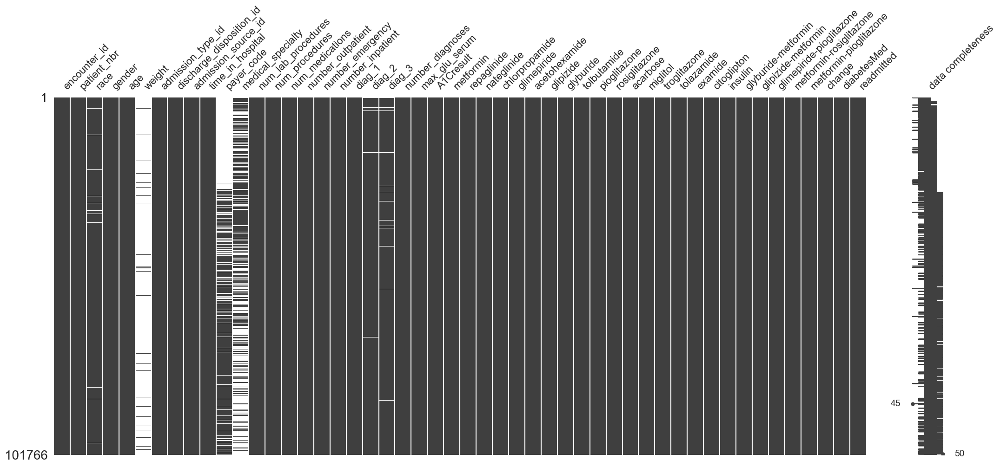

In [345]:
datacopy = diabetes.replace("?", pd.NA)

# Create a msno correlation plot with "?" labeled for missing values
msno.matrix(datacopy, labels=True)

Based on the dataset we have columns that have high number of missing values: 
* Weight: Missing ~99% missing
* Medical Specialty: ~50% missing
* Payer Code: Missing ~40% missing
    * Going to remove all three columns
* Race will be imputed with data based on the mode for readmitted and non readmitted encounters respectively
* Diag_1,2,3 changes to our primary diagnosis and will have imputation based on similar parameters like race
* Removing encounter ID and patient_nbr 
    * Columns are unique identifiers and will highly correlate to our readmission column
    * Focused on the patterns not the individual patient

In [105]:
datacopy = datacopy.drop(columns=['encounter_id','patient_nbr','weight','payer_code','medical_specialty'],axis=1)

In [342]:
datacopy.head(2)

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,No,Up,No,No,No,No,No,Ch,Yes,>30


## Univariate Analysis/Data cleaning

Looking to understand the distribution & different characteristics of each feature

In [12]:
fig = px.histogram(diabetes, x="race", title='Race', width=750, height=400)
fig.show()



* Much more caucasians in this dataset

Will perform Imputation later when building model 

In [347]:
fig = px.histogram(diabetes, x="age", title='Age Not Cleaned', width=750, height=400)
fig.show()
fig2 = px.histogram(diabetes2, x="age", title='Age Cleaned', width=750, height=400)
fig2.show()
print (f'{round(diabetes2["age"].value_counts(normalize=True)*100,2)}')

[70-80)     25.50
[60-70)     22.20
[50-60)     17.17
[80-90)     16.54
[40-50)      9.67
<30          6.30
[90-100)     2.61
Name: age, dtype: float64


In [7]:
fig = px.histogram(diabetes, x="gender", title='Gender Not Cleaned', width=750, height=400)
fig.show()
print(diabetes['gender'].value_counts())
### removing missing rows
to_remove3 = ['Unknown/Invalid']
datacopy = diabetes[~diabetes['gender'].isin(to_remove3)]
fig2 = px.histogram(datacopy, x="gender", title='Gender Cleaned', width=750, height=400)
fig2.show()
print('Removed the three rows missing gender')
print('More females in this sample set by ~8%')


Female             54708
Male               47055
Unknown/Invalid        3
Name: gender, dtype: int64


Removed the three rows missing gender
More females in this sample set by ~8%


In [239]:
fig = px.histogram(diabetes, x="admission_source_id", title='Admission Source ID', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="admission_type_id", title='Admission Type Id', width=750, height=400)
fig.show()
fig = px.histogram(diabetes, x="discharge_disposition_id", title='Discharge Disposition ID', width=750, height=400)
fig.show()


These are categorical features based on the IDs_mapping.csv where the numerical values have a corresponding description
* Discharge_dispition_id Numbers 11, 13, 14, 19, 20, 21 relate to death or hospice care 
    * Removing these rows since they wont readmit

Data type is integer for all three features
* converted to string to fit for categorical features

In [355]:
# removing rows with 11,13,14,19,20,21
to_remove = [11, 13, 14, 19, 20, 21]
datacopy = diabetes[~diabetes['discharge_disposition_id'].isin(to_remove)]
# converting to string
datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']] = datacopy[['admission_type_id','discharge_disposition_id','admission_source_id']].astype('object')
fig = px.histogram(datacopy, x="discharge_disposition_id", title='Discharge Disposition ID Cleaned', width=750, height=400)
fig.show()

In [134]:
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=600, height=400)
fig.show()
fig2 = px.histogram(diabetes, x="diag_2", title='Diag 2', width=600, height=400)
fig2.show()
fig3 = px.histogram(diabetes, x="diag_3", title='Diag 3', width=600, height=400)
fig3.show()

* Will categorize diagnosis codes into different groups of ICD9 problems
    * missing ~ 1 percent for each diagnosis graph will impute later for model building

In [107]:
#Encoding the data,
diabetesv3 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/diabetic_data.csv')
def map_now():
    listname = [('infections', 139),
                ('neoplasms', (239 - 139)),
                ('endocrine', (279 - 239)),
                ('blood', (289 - 279)),
                ('mental', (319 - 289)),
                ('nervous', (359 - 319)),
                ('sense', (389 - 359)),
                ('circulatory', (459-389)),
                ('respiratory', (519-459)),
                ('digestive', (579 - 519)),
                ('genitourinary', (629 - 579)),
                ('pregnancy', (679 - 629)),
                ('skin', (709 - 679)),
                ('musculoskeletal', (739 - 709)),
                ('congenital', (759 - 739)),
                ('perinatal', (779 - 759)),
                ('ill-defined', (799 - 779)),
                ('injury', (999 - 799))]
    
    
    dictcout = {}
    count = 1
    for name, num in listname:
        for i in range(num):
            dictcout.update({str(count): name})  
            count += 1
    return dictcout
  

def codemap(diabetesv3, codes):
    import pandas as pd
    namecol = diabetesv3.columns.tolist()
    for col in namecol:
        temp = [] 
        for num in diabetesv3[col]:           
            if ((num is None) | (num in ['unknown', '?']) | (pd.isnull(num))): temp.append('unknown')
            elif(num.upper()[0] == 'V'): temp.append('supplemental')
            elif(num.upper()[0] == 'E'): temp.append('injury')
            else: 
                lkup = num.split('.')[0]
                temp.append(codes[lkup])           
        diabetesv3.loc[:, col] = temp               
    return diabetesv3 


listcol = ['diag_1', 'diag_2', 'diag_3']
codes = map_now()
datacopy[listcol] = codemap(datacopy[listcol], codes)

In [51]:
fig = px.histogram(datacopy, x="diag_1", title='Diag 1 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_2", title='Diag 2 Cleaned', width=600, height=400)
fig.show()
fig = px.histogram(datacopy, x="diag_3", title='Diag 3 Cleaned', width=600, height=400)
fig.show()


In [145]:
medications = ['metformin','citoglipton', 'examide','repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'glipizide', 'glyburide', 
               'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'insulin', 'glyburide-metformin', 'tolazamide', 
               'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
               'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide']

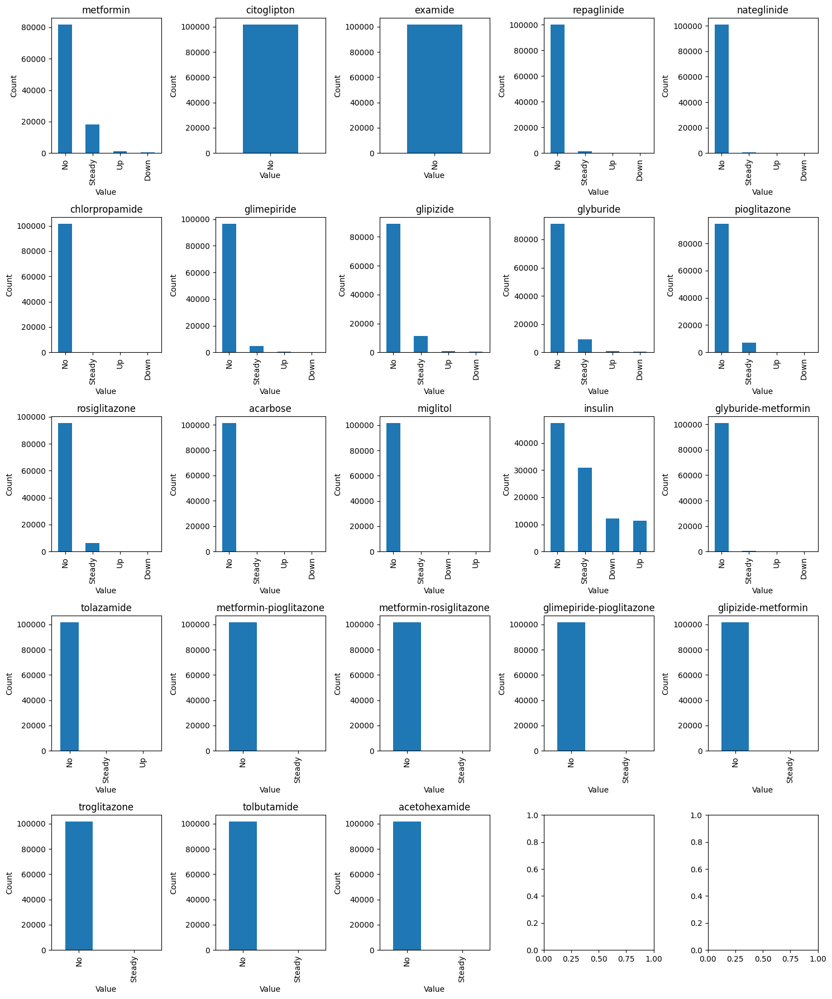

In [147]:
# Create a dictionary to store the count of different values in each column
med_counts = {}
for med in medications:
    med_counts[med] = diabetes[med].value_counts()
# Plot a bar chart for each medication column to show the count of different values
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(15, 18))
for i, ax in enumerate(axes.flat):
    if i < len(medications):
        med_counts[medications[i]].plot(kind='bar', ax=ax)
        ax.set_title(medications[i])
        ax.set_xlabel('Value')
        ax.set_ylabel('Count')
plt.tight_layout()
plt.show()

Medication values were: 
* Steady - Stayed the same 
* Up - Increased 
* Down - Decreased 
* No - Does not take 

We decided to remove a 17 medication due to either having one value or rarley being use
* medications kept: 'insulin', 'metformin', 'glimepiride', 'glipizide', 'glyburide', 'pioglitazone'

In [106]:
datacopy = datacopy.drop(columns=['citoglipton', 'examide', 'repaglinide',
                                  'nateglinide', 'chlorpropamide',
                                  'acarbose', 'miglitol',  'rosiglitazone',  
                                  'glyburide-metformin', 'tolazamide', 
                                  'metformin-pioglitazone','metformin-rosiglitazone', 'glimepiride-pioglitazone', 
                                  'glipizide-metformin', 'troglitazone', 'tolbutamide', 'acetohexamide'])

In [361]:
print("After Cleaning Categorical Data")
print("================================")
print('No of encounters : {}\nNo of features : {}'.format(datacopy.shape[0],datacopy.shape[1]))
print('Numerical features : {} \nCategorical features : {}'.format(datacopy.select_dtypes(exclude=object).shape[1],datacopy.select_dtypes(include=object).shape[1]))


After Cleaning Categorical Data
No of encounters : 99343
No of features : 28
Numerical features : 8 
Categorical features : 20


In [362]:
datacopy.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),6,25,1,1,41,0,1,...,None,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),1,1,7,3,59,0,18,...,None,No,No,No,No,No,Up,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),1,1,7,2,11,5,13,...,None,No,No,Steady,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),1,1,7,2,44,1,16,...,None,No,No,No,No,No,Up,Ch,Yes,NO
4,Caucasian,Male,[40-50),1,1,7,1,51,0,8,...,None,No,No,Steady,No,No,Steady,Ch,Yes,NO


## Numerical Features

In [325]:
numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_emergency', 'number_diagnoses', 'number_outpatient', 'number_inpatient']

In [193]:
diabetes2[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_emergency,number_diagnoses,number_outpatient,number_inpatient
count,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000,99343.000000
mean,4.379332,42.906929,1.334236,15.979062,0.198444,7.401709,0.369246,0.630935
std,2.968409,19.610032,1.702786,8.094909,0.937734,1.941013,1.265142,1.260428
min,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000
25%,2.000000,31.000000,0.000000,10.000000,0.000000,6.000000,0.000000,0.000000
50%,4.000000,44.000000,1.000000,15.000000,0.000000,8.000000,0.000000,0.000000
75%,6.000000,57.000000,2.000000,20.000000,0.000000,9.000000,0.000000,1.000000
max,14.000000,132.000000,6.000000,81.000000,76.000000,16.000000,42.000000,21.000000


Based on the mean/median scores:
* time in hospital - slight right skew (mean 4.4 & median = 4)
* num_lab_procedures - slight left skew (mean 42.9 & median = 44)
* num_procedures - slight right skew (mean = 1.3 & median = 1)
* num_medications - slight right skew (mean = 15.97 & median = 15)     
* number_emergency - High right skew (mean = 0.2 & median = 0)
    * Max value = 76 could mean we have outliers in out dataset
        * Alot of 0's in rows
* number_diagnoses - slight left skew (mean = 7.4 & median = 8)
* number_outpatient - High right skew (mean = 0.37 & median = 0)
    * Max value = 42 could mean we have outliers in out dataset
        * Alot of 0's in rows 
* number_inpatient -  High right skew (mean = 0.63 & median = 0)
    * Max value = 21 could mean we have outliers in out dataset
        * Alot of 0's in rows 

time_in_hospital       1.141853
num_lab_procedures    -0.241522
num_procedures         1.322209
num_medications        1.335408
number_emergency      22.848462
number_diagnoses      -0.861486
number_outpatient      8.839544
number_inpatient       3.633365
dtype: float64


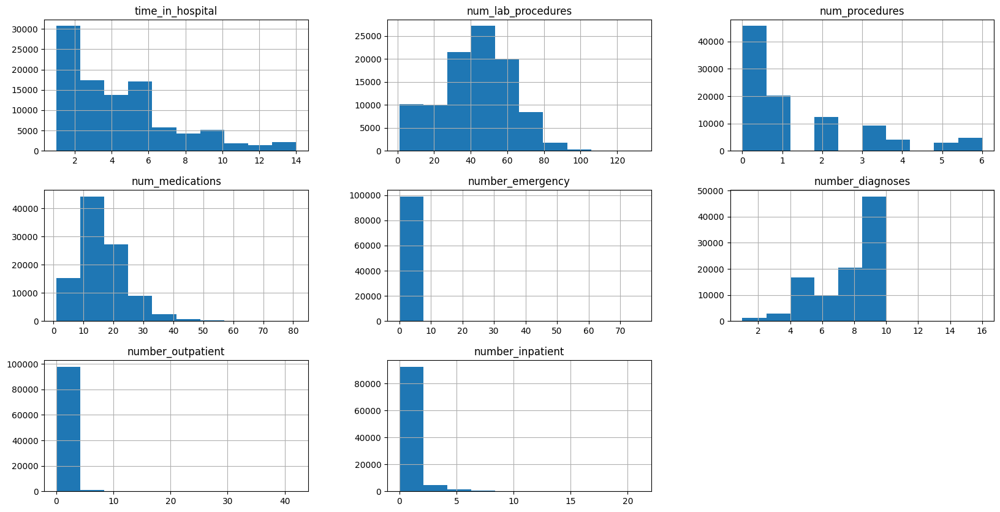

In [221]:
print(diabetes2[numerical].skew())
diabetes2[numerical].hist(figsize=(20,10));

What does this mean? 
* We have Skewed data that can affect:  
    * Accuracy and interpretability of the prediction model
        * May introduce bias
    * Will scale slight skews using Scaler() function from the sklearn package 
* Will need to perform a square root transformation on large skews:
    * To reduce the impact of zeros in the data
    * Number of emergencys
    * Number inpatient
    * Number outpatients
        * During model building


## Bivariate Analysis: 


In [8]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

In [108]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["gender", "readmitted"]).size().reset_index(name="count")

# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["gender", "count"], ascending=[False, True])

# Create a stacked bar chart with gender on x-axis and readmitted as color
color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
fig = px.bar(readmitted_counts, x="gender", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)

# Set the height and width of the chart
fig.update_layout(width=600, height=400)

# Show the chart
fig.show()

# compute probabilities for female/male patients
female_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Female') & (diabetes2['readmitted'] == 'Readmitted')]['gender'].count() / diabetes2[diabetes2['gender'] == 'Female']['gender'].count()
male_prob_gt_30 = diabetes2[(diabetes2['gender'] == 'Male') & (diabetes2['readmitted'] == 'Readmitted')]['gender'].count() / diabetes2[diabetes2['gender'] == 'Male']['gender'].count()
# print out the results
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted within 30 days")

A Female has a probability of 11.46% to be readmitted within 30 days
A Male has a probability of 11.3% to be readmitted within 30 days


Not much of a difference for males vs females who readmitted
* Females slightly higher percentage by ~0.16% 

In [109]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["age", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["age", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color

color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
fig = px.bar(readmitted_counts, x="age", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
# Show the chart
fig.show()
# Print the results
prob_by_age = diabetes2.groupby("age")["readmitted"].value_counts(normalize=True) * 100
prob_by_age = prob_by_age.loc[:, 'Readmitted']
prob_by_age = prob_by_age.sort_values(ascending=False)
print(prob_by_age)

age
[80-90)     12.565413
[70-80)     12.057326
[90-100)    11.896485
[60-70)     11.302022
<30         11.224653
[40-50)     10.658895
[50-60)      9.771395
Name: readmitted, dtype: float64


In [115]:
# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["admission_type_id", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["admission_type_id", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color

color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
fig = px.bar(readmitted_counts, x="admission_type_id", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
# Show the chart
fig.show()
# Print the results
prob_by_admission_type_id = diabetes2.groupby("admission_type_id")["readmitted"].value_counts(normalize=True) * 100
prob_by_admission_type_id = prob_by_admission_type_id.loc[:, 'Readmitted']
prob_by_admission_type_id = prob_by_admission_type_id.sort_values(ascending=False)
print(prob_by_admission_type_id)

admission_type_id
1    11.827608
2    11.350099
6    11.196466
5    10.677929
3    10.489098
4    10.000000
8     8.437500
Name: readmitted, dtype: float64


* 1 = emergency
* 2 = Urgent 
* 3 = Elective

In [148]:
# Count the number of readmissions for each A1Cresult
readmitted_counts = diabetes2.groupby(["A1Cresult", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["A1Cresult", "count"], ascending=[False, True])

color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
# Create a stacked bar chart with A1Cresult on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="A1Cresult", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=500, height=600)
# Show the chart
fig.show()
prob_by_A1Cresult = diabetes2.groupby("A1Cresult")["readmitted"].value_counts(normalize=True) * 100
prob_by_A1Cresult = prob_by_A1Cresult.loc[:, 'Readmitted']
prob_by_A1Cresult = prob_by_A1Cresult.sort_values(ascending=False)
print(prob_by_A1Cresult)


# Count the number of readmissions for each A1Cresult
readmitted_counts = diabetes2.groupby(["insulin", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["insulin", "count"], ascending=[False, True])
color_discrete_map = {"Readmitted": "orange", "Not Readmitted": "blue"}
# Create a stacked bar chart with A1Cresult on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="insulin", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=500, height=600)
# Show the chart
fig.show()
prob_by_insulin = diabetes2.groupby("insulin")["readmitted"].value_counts(normalize=True) * 100
prob_by_insulin = prob_by_insulin.loc[:, 'Readmitted']
prob_by_insulin = prob_by_insulin.sort_values(ascending=False)
print(prob_by_insulin)



# Count the number of readmissions for each gender
readmitted_counts = diabetes2.groupby(["change", "readmitted"]).size().reset_index(name="count")
readmitted_counts2 = diabetes2.groupby(["diabetesMed", "readmitted"]).size().reset_index(name="count")
# Sort the counts in ascending order by the lower count value
readmitted_counts = readmitted_counts.sort_values(["change", "count"], ascending=[False, True])
readmitted_counts2 = readmitted_counts2.sort_values(["diabetesMed", "count"], ascending=[False, True])
# Create a stacked bar chart with gender on x-axis and readmitted as color
fig = px.bar(readmitted_counts, x="change", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
fig2 = px.bar(readmitted_counts2, x="diabetesMed", y="count", color="readmitted", barmode="stack", color_discrete_map=color_discrete_map)
# Set the height and width of the chart
fig.update_layout(width=600, height=400)
fig2.update_layout(width=600, height=400)
# Show the chart
fig.show()
fig2.show()

prob_by_change = diabetes2.groupby("change")["readmitted"].value_counts(normalize=True) * 100
prob_by_change = prob_by_change.loc[:, 'Readmitted']
prob_by_change = prob_by_change.sort_values(ascending=False)
print(prob_by_change)
prob_by_diabetesMed = diabetes2.groupby("diabetesMed")["readmitted"].value_counts(normalize=True) * 100
prob_by_diabetesMed = prob_by_diabetesMed.loc[:, 'Readmitted']
prob_by_diabetesMed = prob_by_diabetesMed.sort_values(ascending=False)
print(prob_by_diabetesMed)

A1Cresult
None    11.685211
>7      10.145695
>8       9.942239
Norm     9.772450
Name: readmitted, dtype: float64


insulin
Down      14.217333
Up        13.333940
Steady    11.373840
No        10.212179
Name: readmitted, dtype: float64


change
Ch    12.022984
No    10.839910
Name: readmitted, dtype: float64
diabetesMed
Yes    11.837011
No      9.870486
Name: readmitted, dtype: float64


Taking a look at weather or not changes in medication have an effect on readmission rates and if those changes were towards diabetes medication: 
* A1C variable has alot of values in the "None" category, which may indicate that it was not measured in some patients, it is still a clinically relevant and an important variable to use for our readmission model
* Insulin shows how changes in medications can impact readmission further confirmed by the changes and diabetes medicaition graphs
* Encounters who had a change in medications readmit 12% of the time in <30 days
* Encounters who have diabetes medication were found to readmit 12% of the time in <30 days
    * can also say that alot more people who had encounters had diabetes medication

## Measuring Categorical and Numerical Features

### Correlation matrix

In [370]:
diabetes2.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,<30,6,25,1,1,41,0,1,...,None,No,No,No,No,No,No,No,No,Not Readmitted
1,Caucasian,Female,<30,1,1,7,3,59,0,18,...,None,No,No,No,No,No,Up,Ch,Yes,Not Readmitted
2,AfricanAmerican,Female,<30,1,1,7,2,11,5,13,...,None,No,No,Steady,No,No,No,No,Yes,Not Readmitted
3,Caucasian,Male,<30,1,1,7,2,44,1,16,...,None,No,No,No,No,No,Up,Ch,Yes,Not Readmitted
4,Caucasian,Male,[40-50),1,1,7,1,51,0,8,...,None,No,No,Steady,No,No,Steady,Ch,Yes,Not Readmitted


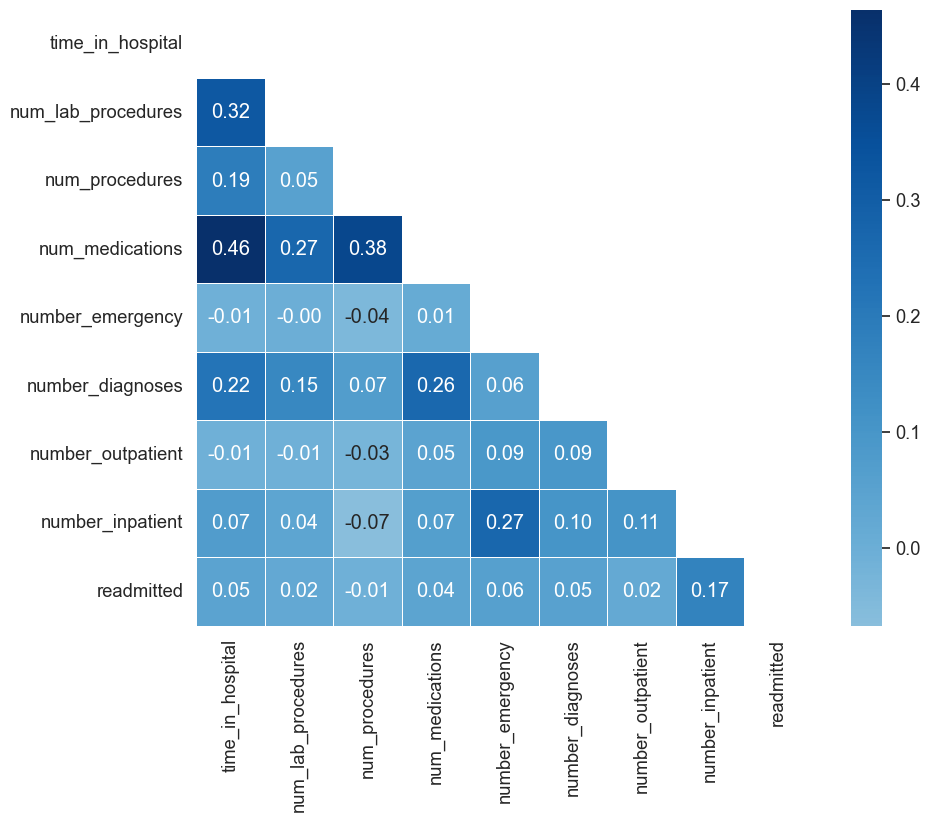

In [335]:
readmission_col = 'readmitted'
# Create a new dataframe with the numerical and readmission columns
numerical_df = diabetes2[numerical + [readmission_col]]

# Calculate the correlation matrix
corr_matrix = numerical_df.corr()

# Plot the correlation matrix using a heatmap
sns.set(font_scale=1.2)
sns.set_style("white")
mask = np.zeros_like(corr_matrix)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, mask=mask, annot=True, fmt=".2f", cmap='Blues', center=0, square=True, linewidths=0.5)
plt.show()

* Correlation matrix: 
    * Not much numerical variables correlate to readmitted columns
        * Imbalance dataset

### Mutual Info Score: 

* The degree of dependency between a categorical variable and the target variable can be measured by using a mutual info score
    * Higher values = higher degree of dependence

In [76]:
categorical = ['race', 'age', 'gender', 'admission_type_id', 'admission_source_id',
               'discharge_disposition_id',
               'diag_1', 'diag_2', 'diag_3', 
               'max_glu_serum', 'A1Cresult', 'insulin', 'metformin', 'repaglinide',
               'glimepiride', 'glipizide', 'glyburide', 'pioglitazone', 'rosiglitazone',
               'change', 'diabetesMed']

In [77]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes2['readmitted']) 

diabetes2_cat = diabetes2[categorical].apply(cat_mut_inf) 
diabetes2_cat = diabetes2_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetes2_cat

,mutual_info_score
discharge_disposition_id,0.005603
diag_3,0.001036
diag_1,0.001001
insulin,0.000973
diag_2,0.000744
metformin,0.000366
diabetesMed,0.000347
admission_source_id,0.000312
age,0.000296
A1Cresult,0.000221


* As seen above, most of the categorical variables have almost no effect on the target variable.
    * Takes into account the frequency of each value in each column
        * Remember we have an imbalance for our target varaible

## A little bit of cleaning before createing the ML model

In [80]:
diabetes2 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav2.csv')
diabetes2 = diabetes2.iloc[:, 1:]

Going to clean the dataset alittle bit more so it can fit the ML model better

In [81]:
# applying square root transformation on right skewed count data to reduce the effects of extreme values (aka 0)
diabetes2['number_outpatient'] = diabetes2['number_outpatient'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_emergency'] = diabetes2['number_emergency'].apply(lambda x: np.sqrt(x + 0.5))
diabetes2['number_inpatient'] = diabetes2['number_inpatient'].apply(lambda x: np.sqrt(x + 0.5))

#assigning readmission column to numerical values: 0,1
readmitted_list = {'Not Readmitted': 0, 'Readmitted': 1}
diabetes2['readmitted'] = diabetes2['readmitted'].map(readmitted_list)

# Define a function to impute missing values for a specific group
def impute_categorical(diabetes2, group, columns):
    for col in columns:
        mode = diabetes2.loc[diabetes2['readmitted'] == group, col].mode()[0]
        diabetes2.loc[(diabetes2[col] == '?') | (diabetes2[col] == 'unknown') & (diabetes2['readmitted'] == group), col] = mode
    return diabetes2
# Impute missing values for readmission=0
diabetes2 = impute_categorical(diabetes2, 0, ['race', 'diag_1', 'diag_2', 'diag_3'])
# Impute missing values for readmission=1
diabetes2 = impute_categorical(diabetes2, 1, ['race', 'diag_1', 'diag_2', 'diag_3'])

One hot encoding for categorical data
* converts categorical data as machine readable numbers
    * Takes a variable and converts each category into it own binary column
        * Ex: Gender = male/female creates two new columns called gender_male/gender_female 
            * new columns get a binary output of 0/1 aka true or false for that encounter

In [82]:
cols_to_encode = ['race', 'age', 'gender', 
                  'admission_type_id', 'admission_source_id',
                  'discharge_disposition_id',
                  'diag_1', 'diag_2', 'diag_3', 
                  'max_glu_serum', 'A1Cresult', 
                  'insulin', 'metformin','glimepiride', 
                  'glipizide', 'glyburide', 
                  'pioglitazone',
                  'change', 'diabetesMed']
# loop through each column and dummy encode it
for col in cols_to_encode:
    # convert the column to string type to avoid errors
    diabetes2[col] = diabetes2[col].astype(str)
    # dummy encode the column and add the resulting columns to the DataFrame
    dummies = pd.get_dummies(diabetes2[col], prefix=col)
    diabetes2 = pd.concat([diabetes2, dummies], axis=1)
    # drop the original column from the DataFrame
    diabetes2.drop(col, axis=1, inplace=True)

In [83]:
diabetes2.head(2)

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,readmitted,race_AfricanAmerican,...,glyburide_Steady,glyburide_Up,pioglitazone_Down,pioglitazone_No,pioglitazone_Steady,pioglitazone_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,1,41,0,1,0.707107,0.707107,0.707107,1,0,0,...,0,0,0,1,0,0,0,1,1,0
1,3,59,0,18,0.707107,0.707107,0.707107,9,0,0,...,0,0,0,1,0,0,1,0,0,1


In [84]:
diabetes2.to_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav3.csv')

# Breaking The Data Up Into Training, Validation, & Testing Sets

In [120]:
diabetes3 = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandatav3.csv')
diabetes3 = diabetes3.iloc[:, 1:]
regex = re.compile(r"\[|\]|<", re.IGNORECASE)
diabetes3.columns = [regex.sub("_", col) if any(x in str(col) for x in set(('[', ']', '<'))) else col for col in diabetes3.columns.values]

In [121]:
train_df, valid_df, test_df = np.split(diabetes3.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetes3)), int(0.85*len(diabetes3))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

* Splitting sets into: 
    * 70% - train set
    * 15% - valid set 
    * 15% - test set

In [122]:
diabetes3.readmitted.value_counts()

0    88026
1    11314
Name: readmitted, dtype: int64

In [123]:
train_df.readmitted.value_counts()

0    61622
1     7916
Name: readmitted, dtype: int64

In [124]:
valid_df.readmitted.value_counts()

0    13194
1     1707
Name: readmitted, dtype: int64

In [125]:
test_df.readmitted.value_counts()

0    13210
1     1691
Name: readmitted, dtype: int64

Broke Sets into: 
* 70% TRAINING
* 15% Valdiation
* 15% Testing

Why did we break the dataset into 3 different sets? 
* Training set: 
    * Trains the model on the input variables we gave it
        * should not be used to evaluate the different models performance
* Validation set (MOST IMPORANT ONE FOR US): 
    * Used to help pick models for hyperparementers tunning  and select the best features 
* Testing set: 
    * Used to evaulate the models performance on new/unseen data 
        * for future use evaluation

In [126]:
def calc_prevalence(y_actual):
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    Params:
    1. y_actual: The target feature
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    return (sum(y_actual)/len(y_actual))

In [127]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
diabetes_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# shuffle the order of training samples 
diabetes_df_balanced = diabetes_df_balanced.sample(n = len(diabetes_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(diabetes_df_balanced), \
                                                calc_prevalence(diabetes_df_balanced.readmitted.values)))

Train balanced prevalence(n = 15832):0.500


In [128]:
diabetes_df_balanced.readmitted.value_counts()

0    7916
1    7916
Name: readmitted, dtype: int64

* We split the training set into postive and negative cases
    * readmitted (1 = postive cases)
    * Not readmitted (0 = negative cases)
* Creates a balanced dataset where we are randomly sampling the negative class to match the size of our postive classes
    * Ensuring equal number of postive and negative cases

In [129]:
X_train = diabetes_df_balanced.drop('readmitted',axis=1)

y_train = diabetes_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [130]:
# scaling our numerical values to fit the model
scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications'])

In [131]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual == 0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

In [132]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)

print('Linear Regression:')
y_valid_preds = lnr.predict(X_valid)
lnr_valid_auc, lnr_valid_accuracy, lnr_valid_recall, \
    lnr_valid_precision, lnr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Linear Regression:
AUC:0.666
accuracy:0.666
recall:0.550
precision:0.183
specificity:0.681
prevalence:0.115
 


In [133]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Logistic Regression:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Logistic Regression:
AUC:0.667
accuracy:0.664
recall:0.553
precision:0.182
specificity:0.678
prevalence:0.115
 


In [134]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]
print('KNeighborsClassifier:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

KNeighborsClassifier:
AUC:0.638
accuracy:0.638
recall:0.547
precision:0.168
specificity:0.606
prevalence:0.115
 


In [135]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent:
AUC:0.646
accuracy:0.558
recall:0.665
precision:0.159
specificity:0.544
prevalence:0.115
 


In [136]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)
print('Decision Tree:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

Decision Tree:
AUC:0.619
accuracy:0.565
recall:0.624
precision:0.154
specificity:0.555
prevalence:0.115
 


In [137]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)
rf_clf.fit(X_train, y_train)
rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

print('Random Forest:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

Random Forest:
AUC:0.665
accuracy:0.610
recall:0.621
precision:0.170
specificity:0.609
prevalence:0.115
 


In [138]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)
print('LinearSVC:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

LinearSVC:
AUC:0.667
accuracy:0.871
recall:0.119
precision:0.324
specificity:0.968
prevalence:0.115
 


In [139]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]
print('Gradient Boosting:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

Gradient Boosting:
AUC:0.633
accuracy:0.607
recall:0.593
precision:0.164
specificity:0.609
prevalence:0.115
 


In [155]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]
print('XGB:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

XGB:
AUC:0.642
accuracy:0.615
recall:0.602
precision:0.169
specificity:0.617
prevalence:0.115
 


In [149]:
catb = CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state=111, silent=True)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

print('Cat Boost:')
lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid, catb_preds, 0.5)

Cat Boost:
AUC:0.627
accuracy:0.607
recall:0.573
precision:0.160
specificity:0.612
prevalence:0.115
 


In [75]:
recall_scoring = make_scorer(recall_score)

# Hyperparameter Tuning

* Will be taking the best 4 models based on the validation sets and will perfrom hyperparameter tuning: 
    * SGD, Decision Tree, Random Forest, XGB
    * Parameters set/changed by us that that infulenece the learning of the different model on the training set
        * based on the metrics we are looking for AUC, recall

##  Stochastic Gradient Descent Hyperparameter

In [150]:
param_grid = {'alpha': [0.001, 0.01, 0.1, 1],
              'penalty': ['l1', 'l2'],
              'loss': ['hinge', 'log', 'perceptron'],}

sgdc = SGDClassifier(random_state=42)

grid_search = GridSearchCV(estimator=sgdc, param_grid=param_grid, cv=5)
grid_search.fit(X_train, y_train)

print("Best parameters found:", grid_search.best_params_)

sgdc = grid_search.best_estimator_

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
    sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)


Best parameters found: {'alpha': 0.01, 'loss': 'log', 'penalty': 'l2'}
Stochastic Gradient Descent:
AUC:0.666
accuracy:0.717
recall:0.481
precision:0.198
specificity:0.748
prevalence:0.115
 


* This shows that our model for SGD had more capablity of distinguishing between postive and negative cases
* However the models recall score went down indicating that it performed worse at correctly identifying the postive samples
    * Will not use for relative feature performace

##  Decision Tree Hyperparameter

In [77]:
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.54885060303724

In [78]:
recall_score(y_valid, dc_hp_preds)

0.7973052138254247

* This shows that our model for decision tree had less capablity of distinguishing between postive and negative cases
* However the models recall score went up indicating that it was better at correctly identifying the postive samples
    * Will not use for relative feature performace

## Random Forest Hyperparamter

In [142]:
rf_grid = {'n_estimators':range(200,1000,200), # number of trees
           'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

rf_random = RandomizedSearchCV(estimator = rf_clf, param_distributions = rf_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

rf_random.fit(X_train, y_train)

rf_random.best_params_

rf_hp_preds = rf_random.best_estimator_.predict(X_valid)
rf_hp_preds_proba = rf_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, rf_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.670103193486166

In [410]:
recall_score(y_valid, rf_hp_preds)

0.6303456356180434

## XGB Hyperparameter

In [141]:
# Define the hyperparameter grid to search over
param_grid = {'max_depth': [3, 6, 9],
              'learning_rate': [0.01, 0.1, 1.0],
              'n_estimators': [100, 500, 1000]}


xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
grid_search = GridSearchCV(xgb_clf, param_grid, cv=5, n_jobs=-1)
grid_search.fit(X_train, y_train)

# Print the best hyperparameters found by GridSearchCV
print('Best hyperparameters:', grid_search.best_params_)

# Make predictions and evaluate the model on the validation set using the best hyperparameters
xgb_clf_best = grid_search.best_estimator_
xgb_preds = xgb_clf_best.predict(X_valid)
xgb_preds_proba = xgb_clf_best.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

Best hyperparameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
AUC:0.670
accuracy:0.619
recall:0.614
precision:0.173
specificity:0.620
prevalence:0.115
 


Comparing xgb and randon forest:
* both models increased in both recall and auc
    * Random forest performed (in terms of recall) better so we will use this for feature selection
        * Will use for relative feature performace importance3

## Using Random Forest Hyperparameter To Find Variables That Realate To Our Target Variable

Top 10 features are: 
number_inpatient
discharge_disposition_id_1
number_emergency
num_medications
discharge_disposition_id_22
num_lab_procedures
time_in_hospital
number_diagnoses
number_outpatient
num_procedures


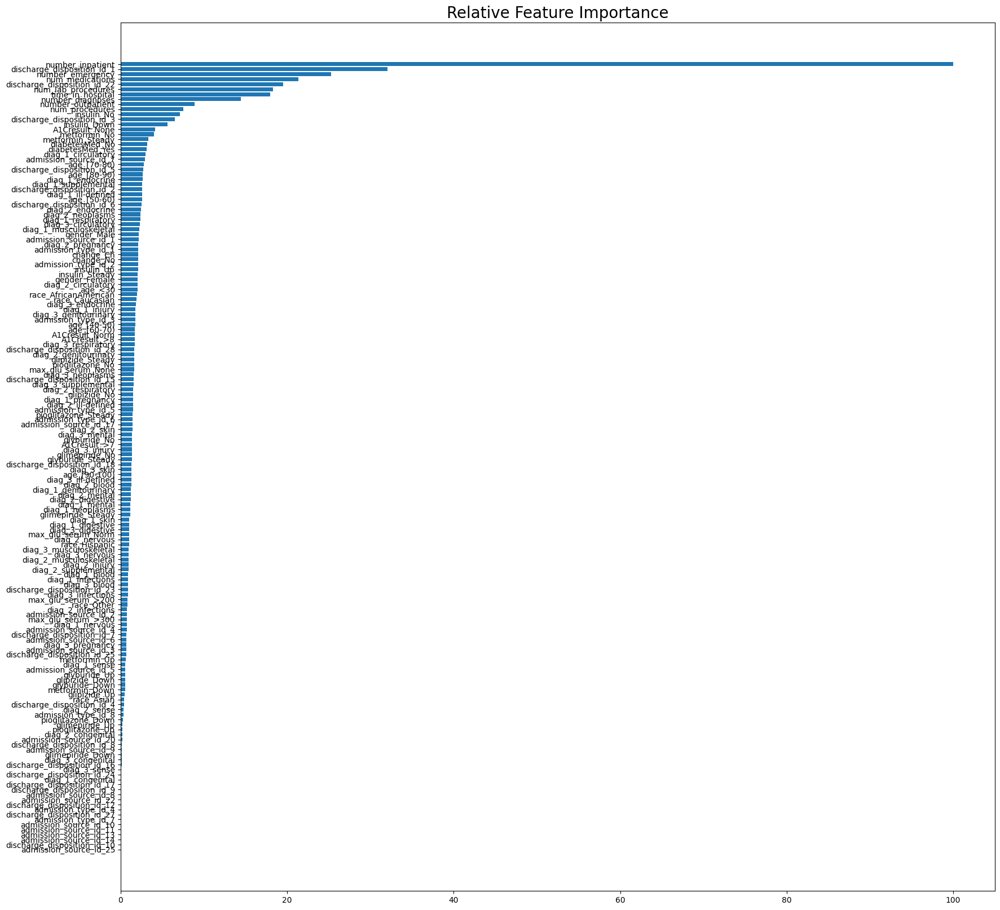

In [117]:
# plot relative feature importance
importances = rf_random.best_estimator_.feature_importances_
feature_importance = 100.0 * (importances / importances.max())
sorted_idx = np.argsort(feature_importance)
feature_names = list(X_train.columns.values)
feature_names_sort = [feature_names[indice] for indice in sorted_idx]
pos = np.arange(sorted_idx.shape[0]) + .5
print('Top 10 features are: ')
for feature in feature_names_sort[::-1][:10]:
    print(feature)
plt.figure(figsize=(20, 20))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, feature_names_sort)
plt.title('Relative Feature Importance', fontsize=20)
plt.show()